In [82]:
using Pkg
Pkg.add("Plots")

using Plots

   Resolving package versions...
      Compat entries added for 
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Project.toml`
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Manifest.toml`


# 复制者动态模型

In [83]:
Pkg.add("Random")
Pkg.add("Statistics")
Pkg.add("Distributions")
using Random
using Statistics
using Distributions

   Resolving package versions...
      Compat entries added for 
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Project.toml`
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Manifest.toml`
   Resolving package versions...
      Compat entries added for 
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Project.toml`
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Manifest.toml`
   Resolving package versions...
      Compat entries added for 
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Project.toml`
  No Changes to `~/code/julia_work/dubcmp/DubCmp/Manifest.toml`


In [84]:
# 计算最后选择策略的得分
function calculate_final_score(P_t, R)
    # 计算每个策略的奖励 u_t(a)
    u_t = [calculate_u_t(a, P_t, R) for a in 1:length(P_t)]
    
    # 计算策略的期望奖励（加权和）
    score = sum(P_t .* u_t)
    
    return score
end

# 生成高斯分布的策略分布
function initialize_gaussian_distribution(m, mean=0.0, stddev=1.0)
    # Random.seed!(1408)
    # 生成符合高斯分布的随机数
    gauss_values = mean .+ stddev .* randn(m)
    
    # 归一化处理，使策略的概率之和为 1
    P_0 = exp.(gauss_values)  # 使用指数映射确保正值
    P_0 .= P_0 ./ sum(P_0)    # 归一化

    return P_0
end


initialize_gaussian_distribution (generic function with 3 methods)

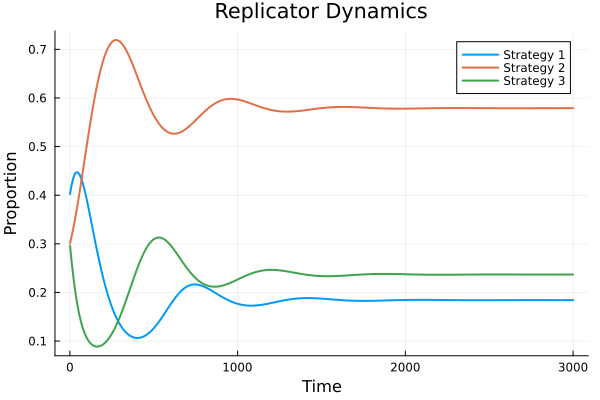

attempt to save state beyond implementation limit


In [85]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    # 使用广播来计算每个策略的奖励
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

function update_P_t(P_t, R, dt)
    m = length(P_t)
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布
    return P_t
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end


# 示例：初始化参数
A = 1:3  # 假设有3种策略
P_0 = [0.4, 0.3, 0.3]  # 初始分布
R = [  # 囚徒困境 R(a, b)
    3.0  0.0  5.0;
    5.0  1.0  1.0;
    0.0  3.0  0.0
]
# R = [  # 雪堆博弈 R(a, b)
#     3.0  5.0  0.0;
#     5.0  1.0  1.0;
#     0.0  3.0  0.0
# ]
# R = [  # 猎鹿博弈 R(a, b)
#     3.0  0.0  5.0;
#     5.0  2.0  2.0;
#     0.0  3.0  0.0
# ]


# 时间步长
dt = 0.01
t_max = 3000  # 总的模拟时间


# 用于存储每个时间步的策略分布
P_t_history = []

# 模拟复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t = update_P_t(P_t, R, dt)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
end

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Replicator Dynamics", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)

# 模型的局限性：
- 只能两两互动
- 多个代理人的策略和奖励不应该完全相同

__因此引出随机博弈__

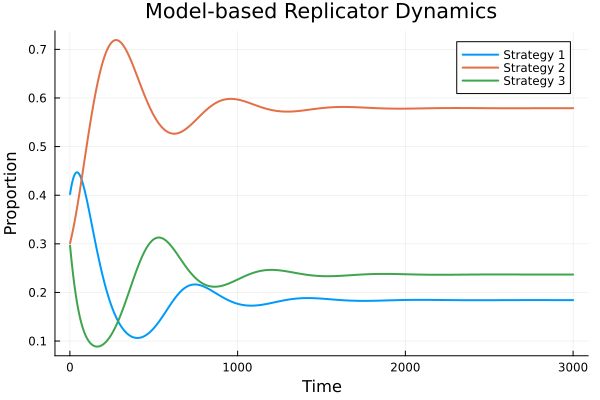

In [86]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end

# 初始化对手策略模型
function initialize_opponent_model(m)
    # 假设对手初始策略分布均匀
    return ones(m) / m
end

# 更新对手策略模型（通过遍历自己的策略选择最优响应）
function update_opponent_model(opponent_model, P_t, R, alpha=0.1)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（自己的策略）
    for i in 1:m
        # 计算当前策略与对手策略的奖励
        reward_i = sum(opponent_model .* [reward(i, j, R) for j in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_i > max_reward
            max_reward = reward_i
            best_response = i
        end
    end
    
    # 选择最佳响应后，更新对手策略模型
    opponent_model .= (1 - alpha) .* opponent_model .+ alpha .* P_t[best_response]

    return opponent_model
end

# 更新策略分布（基于模型的复制者动态）
function update_P_t(P_t, R, opponent_model, dt)
    m = length(P_t)
    
    # 计算代理当前的奖励
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    
    # 基于对手模型计算最佳响应
    best_response = calculate_best_response(P_t, opponent_model, R)
    
    # 代理策略的更新（复制者动态更新）
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布
    
    # 更新对手模型（基于观察的对手行为）
    opponent_model = update_opponent_model(opponent_model, P_t, R)
    
    return P_t, opponent_model
end

# 计算策略 a 的最佳响应
function calculate_best_response(agent_strategy, opponent_model, R)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf
    for i in 1:m
        reward_i = calculate_u_t(i, opponent_model, R)
        if reward_i > max_reward
            max_reward = reward_i
            best_response = i
        end
    end
    return best_response
end

# 示例：初始化参数
A = 1:3  # 假设有3种策略
P_0 = [0.4, 0.3, 0.3]  # 初始分布
R = [  # 囚徒困境 R(a, b)
    3.0  0.0  5.0;
    5.0  1.0  1.0;
    0.0  3.0  0.0
]

# 时间步长
dt = 0.01
t_max = 3000  # 总的模拟时间

# 用于存储每个时间步的策略分布
P_t_history = []

# 初始化对手策略模型
opponent_model = initialize_opponent_model(length(P_0))

# 模拟基于模型的复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t, opponent_model = update_P_t(P_t, R, opponent_model, dt)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
end

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
using Plots
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Model-based Replicator Dynamics", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)


Final score of the selected strategies: 2.7678392141790398


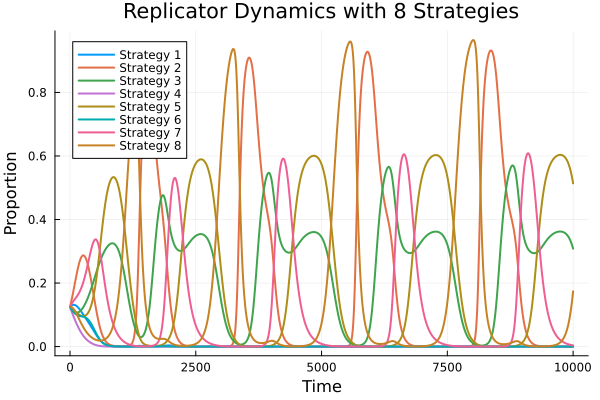

In [87]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    # 使用广播来计算每个策略的奖励
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end

# 更新策略分布
function update_P_t(P_t, R, dt)
    m = length(P_t)
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布
    return P_t
end

# 示例：初始化参数
A = 1:8  # 假设有8种策略
P_0 = [0.125 for _ in 1:8]  # 初始分布为均匀分布
R = [  # 囚徒困境 8个策略的奖励矩阵
    3.0  0.0  5.0  0.0  0.0  5.0  0.0  3.0;
    5.0  1.0  1.0  3.0  2.0  1.0  1.0  5.0;
    0.0  3.0  0.0  2.0  5.0  0.0  3.0  0.0;
    5.0  0.0  3.0  1.0  1.0  2.0  0.0  0.0;
    3.0  0.0  5.0  0.0  2.0  1.0  3.0  0.0;
    1.0  3.0  0.0  2.0  3.0  2.0  1.0  1.0;
    0.0  2.0  5.0  3.0  1.0  5.0  1.0  0.0;
    1.0  0.0  3.0  2.0  5.0  3.0  0.0  1.0
]

# 时间步长
dt = 0.01
t_max = 10000  # 总的模拟时间

# 用于存储每个时间步的策略分布
P_t_history = []
scores = []

# 模拟复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t = update_P_t(P_t, R, dt)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
    push!(scores, calculate_final_score(P_t, R))
end

# 示例：计算最终策略的得分
final_score = calculate_final_score(P_t, R)
println("Final score of the selected strategies: ", final_score)

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Replicator Dynamics with 8 Strategies", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)
plot!(1:t_max, P_t_history_matrix[4, :], label="Strategy 4", linewidth=2)
plot!(1:t_max, P_t_history_matrix[5, :], label="Strategy 5", linewidth=2)
plot!(1:t_max, P_t_history_matrix[6, :], label="Strategy 6", linewidth=2)
plot!(1:t_max, P_t_history_matrix[7, :], label="Strategy 7", linewidth=2)
plot!(1:t_max, P_t_history_matrix[8, :], label="Strategy 8", linewidth=2)


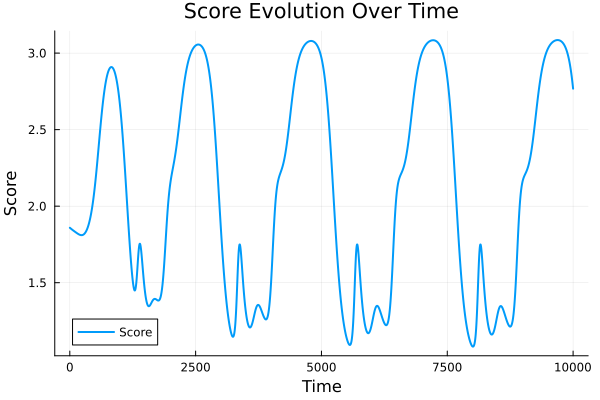

In [88]:
# 画出scores的变化
plot(1:t_max, scores, label="Score", xlabel="Time", ylabel="Score", title="Score Evolution Over Time", linewidth=2)

# 模拟退火

Final score of the selected strategies: 1.8664744482820053


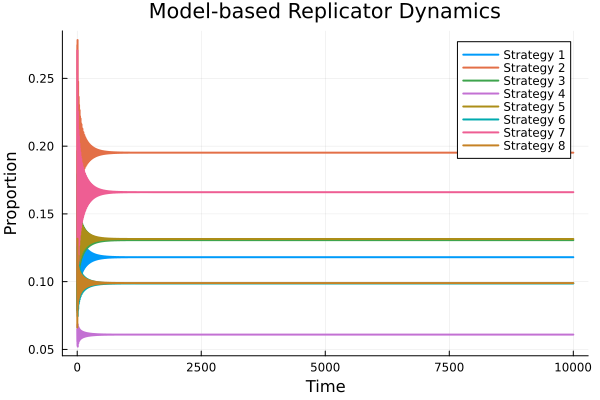

In [89]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end

# 初始化对手策略模型
function initialize_opponent_model(m)
    # 假设对手初始策略分布均匀
    return ones(m) / m
end

# 更新对手策略模型（增加随机性）
function update_opponent_model(opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（自己的策略）
    for i in 1:m
        # 计算当前策略与对手策略的奖励
        reward_i = sum(opponent_model .* [reward(i, j, R) for j in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_i > max_reward
            max_reward = reward_i
            best_response = i
        end
    end
    
    # 增加噪声来避免过于确定的策略选择
    opponent_model .= (1 - alpha) .* opponent_model .+ alpha .* P_t[best_response]
    opponent_model .= opponent_model .+ noise_level * rand(m)  # 增加随机噪声

    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
    
    return opponent_model
end




# 更新策略分布，加入遗忘机制
function update_P_t(P_t, R, opponent_model, dt, forgetting_factor=0.01)
    m = length(P_t)
    
    # 计算代理当前的奖励
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    
    # 基于对手模型计算最佳响应
    best_response = calculate_best_response(P_t, opponent_model, R)
    
    # 代理策略的更新（复制者动态更新）
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布

    # 引入遗忘机制：逐步减少策略对历史奖励的依赖
    P_t .= (1 - forgetting_factor) .* P_t
    
    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)
    
    # 更新对手模型（基于观察的对手行为）
    opponent_model = update_opponent_model(opponent_model, P_t, R)
    
    return P_t, opponent_model
end

# Fermi动态更新方法
function update_P_t_fermi(P_t, R, opponent_model, dt, temperature=0.64375)
    m = length(P_t)
    
    # 计算代理当前的奖励
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    
    # 计算策略的偏好差异
    delta_u = u_t .- u_star
    exponentiated_delta_u = exp.(delta_u ./ temperature)  # 使用广播操作

    # 归一化为概率分布
    P_t .= exponentiated_delta_u ./ sum(exponentiated_delta_u)
    
    # 更新对手模型（基于观察的对手行为）
    opponent_model = update_opponent_model(opponent_model, P_t, R)
    
    return P_t, opponent_model
end




# 计算策略 a 的最佳响应
function calculate_best_response(agent_strategy, opponent_model, R)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf
    for i in 1:m
        reward_i = calculate_u_t(i, opponent_model, R)
        if reward_i > max_reward
            max_reward = reward_i
            best_response = i
        end
    end
    return best_response
end

# 示例：初始化参数
A = 1:8  # 假设有8种策略
P_0 = [0.125 for _ in 1:8]  # 初始分布为均匀分布
R = [  # 8个策略的奖励矩阵
    3.0  0.0  5.0  0.0  0.0  5.0  0.0  3.0;
    5.0  1.0  1.0  3.0  2.0  1.0  1.0  5.0;
    0.0  3.0  0.0  2.0  5.0  0.0  3.0  0.0;
    5.0  0.0  3.0  1.0  1.0  2.0  0.0  0.0;
    3.0  0.0  5.0  0.0  2.0  1.0  3.0  0.0;
    1.0  3.0  0.0  2.0  3.0  2.0  1.0  1.0;
    0.0  2.0  5.0  3.0  1.0  5.0  1.0  0.0;
    1.0  0.0  3.0  2.0  5.0  3.0  0.0  1.0
]
# 时间步长
dt = 0.01
t_max = 10000  # 总的模拟时间

# 用于存储每个时间步的策略分布
P_t_history = []
scores = []

# 初始化对手策略模型
opponent_model = initialize_opponent_model(length(P_0))

# 模拟基于模型的复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t, opponent_model = update_P_t_fermi(P_t, R, opponent_model, dt)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
    push!(scores, calculate_final_score(P_t, R))
end

# 示例：计算最终策略的得分
final_score = calculate_final_score(P_t, R)
println("Final score of the selected strategies: ", final_score)

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Model-based Replicator Dynamics", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)
plot!(1:t_max, P_t_history_matrix[4, :], label="Strategy 4", linewidth=2)
plot!(1:t_max, P_t_history_matrix[5, :], label="Strategy 5", linewidth=2)
plot!(1:t_max, P_t_history_matrix[6, :], label="Strategy 6", linewidth=2)
plot!(1:t_max, P_t_history_matrix[7, :], label="Strategy 7", linewidth=2)
plot!(1:t_max, P_t_history_matrix[8, :], label="Strategy 8", linewidth=2)

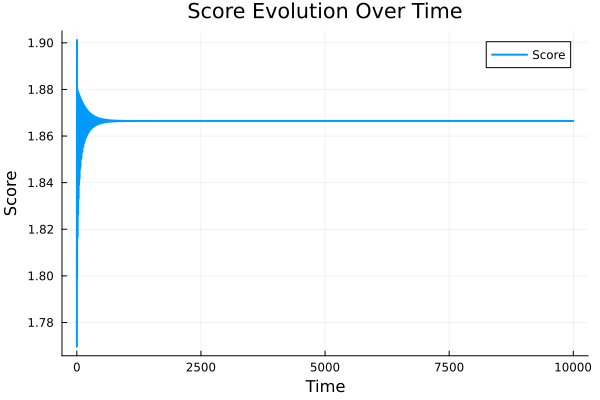

In [90]:
# 画出scores的变化
plot(1:t_max, scores, label="Score", xlabel="Time", ylabel="Score", title="Score Evolution Over Time", linewidth=2)

# 个人最优 无模型学习

Final score of the selected strategies: 2.792852097335128


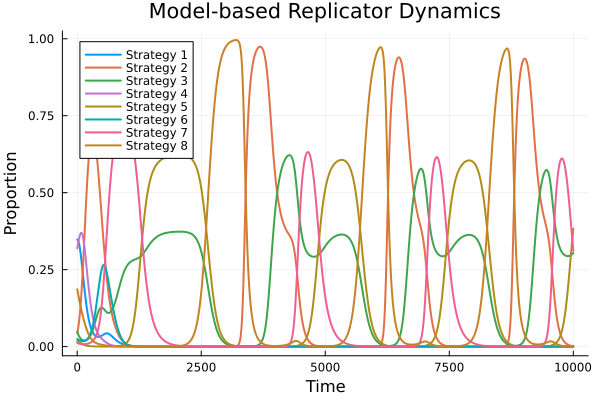

In [91]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end

# 初始化对手策略模型
function initialize_opponent_model(m)
    # 假设对手初始策略分布均匀
    return ones(m) / m
end

# 更新对手策略模型（增加随机性）
function update_opponent_model(opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（自己的策略）
    for i in 1:m
        # 计算当前策略与对手策略的奖励
        reward_i = sum(opponent_model .* [reward(i, j, R) for j in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_i > max_reward
            max_reward = reward_i
            best_response = i
        end
    end
    
    # 增加噪声来避免过于确定的策略选择
    opponent_model .= (1 - alpha) .* opponent_model .+ alpha .* P_t[best_response]
    opponent_model .= opponent_model .+ noise_level * rand(m)  # 增加随机噪声

    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
    
    return opponent_model
end




# 更新策略分布，加入遗忘机制
function update_P_t(P_t, R, opponent_model, dt, forgetting_factor=0.01)
    m = length(P_t)
    
    # 计算代理当前的奖励
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    
    # 基于对手模型计算最佳响应
    best_response = calculate_best_response(P_t, opponent_model, R)
    
    # 代理策略的更新（复制者动态更新）
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布

    # 引入遗忘机制：逐步减少策略对历史奖励的依赖
    P_t .= (1 - forgetting_factor) .* P_t
    
    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)
    
    # 更新对手模型（基于观察的对手行为）
    opponent_model = update_opponent_model(opponent_model, P_t, R)
    
    return P_t, opponent_model
end

# 示例：初始化参数
A = 1:8  # 假设有8种策略
P_0 = initialize_gaussian_distribution(8, 0.0, 1.0)  # 初始分布为高斯分布
R = [  # 8个策略的奖励矩阵
    3.0  0.0  5.0  0.0  0.0  5.0  0.0  3.0;
    5.0  1.0  1.0  3.0  2.0  1.0  1.0  5.0;
    0.0  3.0  0.0  2.0  5.0  0.0  3.0  0.0;
    5.0  0.0  3.0  1.0  1.0  2.0  0.0  0.0;
    3.0  0.0  5.0  0.0  2.0  1.0  3.0  0.0;
    1.0  3.0  0.0  2.0  3.0  2.0  1.0  1.0;
    0.0  2.0  5.0  3.0  1.0  5.0  1.0  0.0;
    1.0  0.0  3.0  2.0  5.0  3.0  0.0  1.0
]
# 时间步长
dt = 0.01
t_max = 10000  # 总的模拟时间

# 用于存储每个时间步的策略分布
P_t_history = []
scores = []

# 初始化对手策略模型
opponent_model = initialize_opponent_model(length(P_0))

# 模拟基于模型的复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t, opponent_model = update_P_t(P_t, R, opponent_model, dt)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
    push!(scores, calculate_final_score(P_t, R))
end

# 示例：计算最终策略的得分
final_score = calculate_final_score(P_t, R)
println("Final score of the selected strategies: ", final_score)

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Model-based Replicator Dynamics", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)
plot!(1:t_max, P_t_history_matrix[4, :], label="Strategy 4", linewidth=2)
plot!(1:t_max, P_t_history_matrix[5, :], label="Strategy 5", linewidth=2)
plot!(1:t_max, P_t_history_matrix[6, :], label="Strategy 6", linewidth=2)
plot!(1:t_max, P_t_history_matrix[7, :], label="Strategy 7", linewidth=2)
plot!(1:t_max, P_t_history_matrix[8, :], label="Strategy 8", linewidth=2)

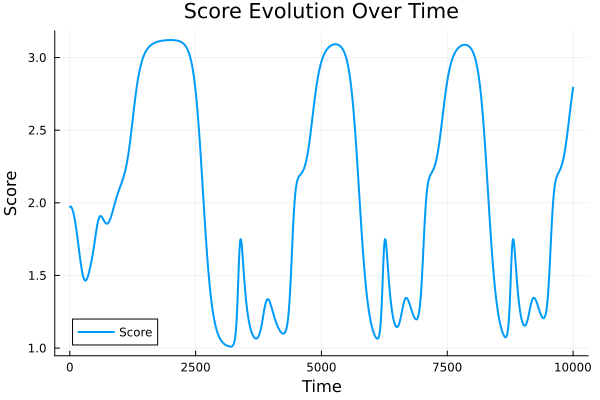

In [92]:
# 画出scores的变化
plot(1:t_max, scores, label="Score", xlabel="Time", ylabel="Score", title="Score Evolution Over Time", linewidth=2)

# 全局最优 calculate_final_score 基于模型的优化

Final score of the selected strategies: 1.8569987157341565


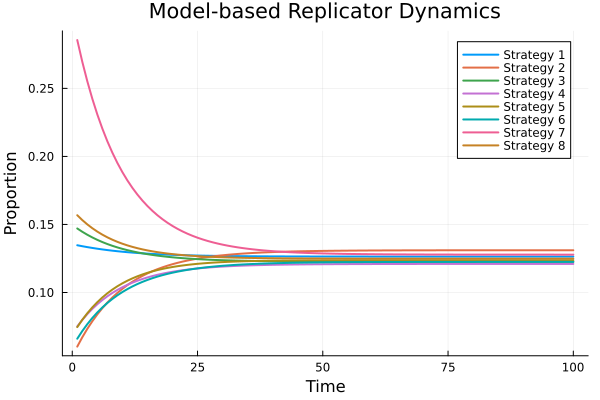

In [93]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end

# 初始化对手策略模型
function initialize_opponent_model(m)
    # 假设对手初始策略分布均匀
    return ones(m) / m
end

# 更新自己的策略模型（使对方奖励最大化）
function update_opponent_model(opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（对方的策略）
    for j in 1:m
        # 计算自己选择当前策略与对方策略的奖励
        reward_j = sum(P_t .* [reward(i, j, R) for i in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_j > max_reward
            max_reward = reward_j
            best_response = j
        end
    end
    
    # 通过调整自己策略使对方的奖励最大化
    P_t .= (1 - alpha) .* P_t .+ alpha .* opponent_model[best_response]

    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)

    
    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
        
    return P_t, opponent_model
end


# 更新策略分布，加入遗忘机制
function update_P_t(P_t, R, opponent_model, dt, forgetting_factor=0.01)
    m = length(P_t)
    
    # 计算代理当前的奖励
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    
    # 代理策略的更新（复制者动态更新）
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布

    # 引入遗忘机制：逐步减少策略对历史奖励的依赖
    P_t .= (1 - forgetting_factor) .* P_t
    
    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)
    
    # 更新对手模型（基于观察的对手行为）
    P_t, opponent_model = update_opponent_model(opponent_model, P_t, R)
    
    return P_t, opponent_model
end

# 示例：初始化参数
A = 1:8  # 假设有8种策略
P_0 = initialize_gaussian_distribution(8, 0.0, 1.0)  # 初始分布为高斯分布
R = [  # 8个策略的奖励矩阵
    3.0  0.0  5.0  0.0  0.0  5.0  0.0  3.0;
    5.0  1.0  1.0  3.0  2.0  1.0  1.0  5.0;
    0.0  3.0  0.0  2.0  5.0  0.0  3.0  0.0;
    5.0  0.0  3.0  1.0  1.0  2.0  0.0  0.0;
    3.0  0.0  5.0  0.0  2.0  1.0  3.0  0.0;
    1.0  3.0  0.0  2.0  3.0  2.0  1.0  1.0;
    0.0  2.0  5.0  3.0  1.0  5.0  1.0  0.0;
    1.0  0.0  3.0  2.0  5.0  3.0  0.0  1.0
]
# 时间步长
dt = 0.01
t_max = 100 # 总的模拟时间

# 用于存储每个时间步的策略分布
P_t_history = []
scores = []

# 初始化对手策略模型
opponent_model = initialize_opponent_model(length(P_0))

# 模拟基于模型的复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t, opponent_model = update_P_t(P_t, R, opponent_model, dt)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
    push!(scores, calculate_final_score(P_t, R))
end

# 示例：计算最终策略的得分
final_score = calculate_final_score(P_t, R)
println("Final score of the selected strategies: ", final_score)

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Model-based Replicator Dynamics", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)
plot!(1:t_max, P_t_history_matrix[4, :], label="Strategy 4", linewidth=2)
plot!(1:t_max, P_t_history_matrix[5, :], label="Strategy 5", linewidth=2)
plot!(1:t_max, P_t_history_matrix[6, :], label="Strategy 6", linewidth=2)
plot!(1:t_max, P_t_history_matrix[7, :], label="Strategy 7", linewidth=2)
plot!(1:t_max, P_t_history_matrix[8, :], label="Strategy 8", linewidth=2)

因此出现每个代理人全局着想，反而得分不高的情况发生

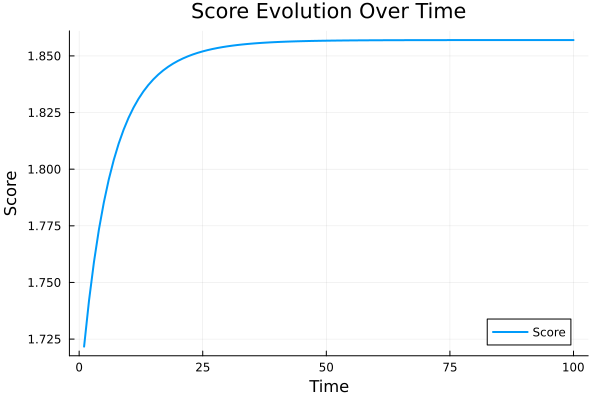

In [94]:
# 画出scores的变化
plot(1:t_max, scores, label="Score", xlabel="Time", ylabel="Score", title="Score Evolution Over Time", linewidth=2)

# 正确的思路

**代理人与对手作为leader 或 follower** 

__局限性：1. 代理人之间只是端对端的，2. 每个代理人的决策是平等的__

# 混合型

In [415]:
function initialize_weight(m)
    # 生成一个对角线为1的上三角随机矩阵
    U = zeros(m, m)
    I = ones(m, m)
    # 将矩阵 U 转化为上三角矩阵，并保证对角线元素为 1
    for i in 1:m
        for j in i:m
            if i == j
                U[i, j] = 1
            else
                U[i, j] = rand()
            end
        end
    end
    
    # 计算 weight = U + U'
    weight = U + (I - U)'
    
    return weight ./ 2
end

function initialize_coopration_weight(m)
    # 生成一个对角线为1的上三角随机矩阵
    U = zeros(m, m)
    I = ones(m, m)
    # 将矩阵 U 转化为上三角矩阵，并保证对角线元素为 1
    for i in 1:m
        for j in i:m
            if i == j
                U[i, j] = 0.5
            else
                U[i, j] = 1
            end
        end
    end
    
    # 计算 weight = U + U'
    weight = U'
    
    return weight
end

function initialize_compete_weight(m)
    # 生成一个对角线为1的上三角随机矩阵
    U = zeros(m, m)
    I = ones(m, m)
    # 将矩阵 U 转化为上三角矩阵，并保证对角线元素为 1
    for i in 1:m
        for j in i:m
            if i == j
                U[i, j] = 0.52
            else
                U[i, j] = 1
            end
        end
    end
    
    # 计算 weight = U + U'
    weight = U
    
    return weight
end

weight = initialize_compete_weight(length(A))

8×8 Matrix{Float64}:
 0.52  1.0   1.0   1.0   1.0   1.0   1.0   1.0
 0.0   0.52  1.0   1.0   1.0   1.0   1.0   1.0
 0.0   0.0   0.52  1.0   1.0   1.0   1.0   1.0
 0.0   0.0   0.0   0.52  1.0   1.0   1.0   1.0
 0.0   0.0   0.0   0.0   0.52  1.0   1.0   1.0
 0.0   0.0   0.0   0.0   0.0   0.52  1.0   1.0
 0.0   0.0   0.0   0.0   0.0   0.0   0.52  1.0
 0.0   0.0   0.0   0.0   0.0   0.0   0.0   0.52

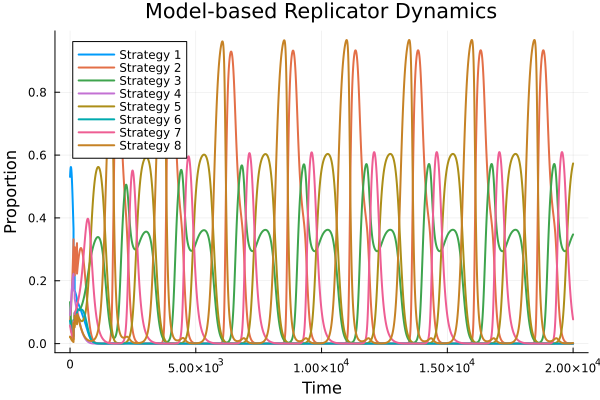

In [96]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end

# 初始化对手策略模型
function initialize_opponent_model(m)
    # 假设对手初始策略分布均匀
    return ones(m) / m
end

# 更新对手策略模型（增加随机性）
function update_compete_model(opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（自己的策略）
    for i in 1:m
        # 计算当前策略与对手策略的奖励
        reward_i = sum(opponent_model .* [reward(i, j, R) for j in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_i > max_reward
            max_reward = reward_i
            best_response = i
        end
    end
    
    # 增加噪声来避免过于确定的策略选择
    opponent_model .= (1 - alpha) .* opponent_model .+ alpha .* P_t[best_response]
    opponent_model .= opponent_model .+ noise_level * rand(m)  # 增加随机噪声

    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
    
    return P_t, opponent_model
end

# 更新自己的策略模型（使对方奖励最大化）
function update_coopration_model(opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（对方的策略）
    for j in 1:m
        # 计算自己选择当前策略与对方策略的奖励
        reward_j = sum(P_t .* [reward(i, j, R) for i in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_j > max_reward
            max_reward = reward_j
            best_response = j
        end
    end
    
    # 通过调整自己策略使对方的奖励最大化
    P_t .= (1 - alpha) .* P_t .+ alpha .* opponent_model[best_response]

    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)

    
    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
        
    return P_t, opponent_model
end

function update_mixed_model(weight, opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response_i = 0
    best_response_j = 0
    max_reward = -Inf

    # 遍历所有可能的策略（混合的策略）
    for i in 1:m
        for j in 1:m
            # 权重分配
            reward_ij = weight[i,j] * sum(P_t .* [reward(i, j, R) for i in 1:m]) + weight[j,i] * sum(opponent_model .* [reward(i, j, R) for j in 1:m])
            if reward_ij > max_reward
                max_reward = reward_ij
                best_response_i = i
                best_response_j = j
            end
        end
    end

    i = best_response_i
    j = best_response_j

    # 合作
    P_t .= weight[i,j] .* P_t .+ weight[j,i] .* opponent_model[best_response_i]

    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)

    # 竞争
    opponent_model .= weight[j,i] .* opponent_model .+ weight[i,j] .* P_t[best_response_j]

    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
    

    return weight, P_t, opponent_model
end


# 更新策略分布，加入遗忘机制
function update_P_t(P_t, R, opponent_model, dt, forgetting_factor=0.02, weight = weight)
    m = length(P_t)
    
    # 计算代理当前的奖励
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    
    # 代理策略的更新（复制者动态更新）
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布

    # 引入遗忘机制：逐步减少策略对历史奖励的依赖
    P_t .= (1 - forgetting_factor) .* P_t
    
    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)
    
    # 更新对手模型（基于观察的对手行为）
    # P_t, opponent_model = update_coopration_model(opponent_model, P_t, R)
    weight, P_t, opponent_model = update_mixed_model(weight, opponent_model, P_t, R)
    
    return P_t, opponent_model, weight
end

# 示例：初始化参数
A = 1:8  # 假设有8种策略
P_0 = initialize_gaussian_distribution(8, 0.0, 1.0)  # 初始分布为高斯分布
R = [  # 8个策略的奖励矩阵
    3.0  0.0  5.0  0.0  0.0  5.0  0.0  3.0;
    5.0  1.0  1.0  3.0  2.0  1.0  1.0  5.0;
    0.0  3.0  0.0  2.0  5.0  0.0  3.0  0.0;
    5.0  0.0  3.0  1.0  1.0  2.0  0.0  0.0;
    3.0  0.0  5.0  0.0  2.0  1.0  3.0  0.0;
    1.0  3.0  0.0  2.0  3.0  2.0  1.0  1.0;
    0.0  2.0  5.0  3.0  1.0  5.0  1.0  0.0;
    1.0  0.0  3.0  2.0  5.0  3.0  0.0  1.0
]
# 时间步长
dt = 0.01
t_max = 20000  # 总的模拟时间

# 用于存储每个时间步的策略分布
P_t_history = []
scores = []

# 初始化对手策略模型
opponent_model = initialize_opponent_model(length(P_0))

# 模拟基于模型的复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t, opponent_model, weight = update_P_t(P_t, R, opponent_model, dt, 0.01, weight)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
    push!(scores, calculate_final_score(P_t, R))
end

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Model-based Replicator Dynamics", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)
plot!(1:t_max, P_t_history_matrix[4, :], label="Strategy 4", linewidth=2)
plot!(1:t_max, P_t_history_matrix[5, :], label="Strategy 5", linewidth=2)
plot!(1:t_max, P_t_history_matrix[6, :], label="Strategy 6", linewidth=2)
plot!(1:t_max, P_t_history_matrix[7, :], label="Strategy 7", linewidth=2)
plot!(1:t_max, P_t_history_matrix[8, :], label="Strategy 8", linewidth=2)

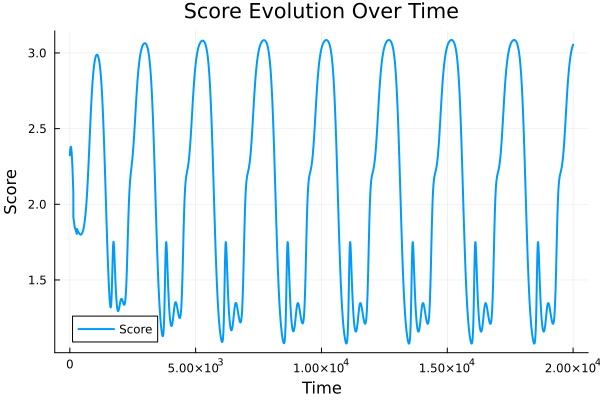

In [97]:
# 画出scores的变化
plot(1:t_max, scores, label="Score", xlabel="Time", ylabel="Score", title="Score Evolution Over Time", linewidth=2)

In [98]:
# 示例：计算最终策略的得分
final_score = calculate_final_score(P_t, R)
# println("Final score of the selected strategies: ", final_score)

3.0549705456607734

In [99]:
weight = initialize_compete_weight(length(A))
# weight = initialize_coopration_weight(length(A))

8×8 Matrix{Float64}:
 0.5  1.0  1.0  1.0  1.0  1.0  1.0  1.0
 0.0  0.5  1.0  1.0  1.0  1.0  1.0  1.0
 0.0  0.0  0.5  1.0  1.0  1.0  1.0  1.0
 0.0  0.0  0.0  0.5  1.0  1.0  1.0  1.0
 0.0  0.0  0.0  0.0  0.5  1.0  1.0  1.0
 0.0  0.0  0.0  0.0  0.0  0.5  1.0  1.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.5  1.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.5

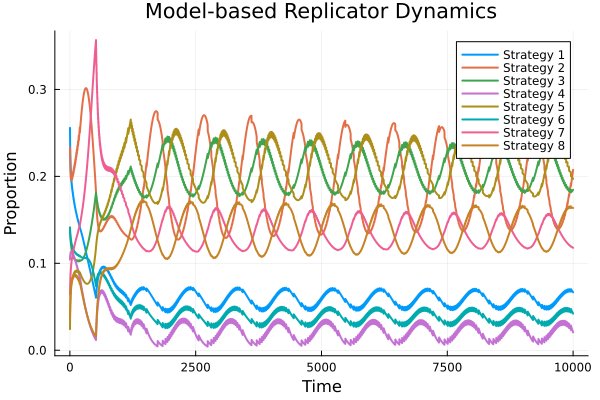

In [416]:
# 定义奖励函数 R(a, b)，这个函数返回当一个代理使用策略 a，而另一个代理使用策略 b 时的奖励
function reward(a, b, R)
    return R[a, b]
end

# 计算策略 a 的奖励 u_t(a)
function calculate_u_t(a, P_t, R)
    return sum(P_t .* [reward(a, i, R) for i in 1:length(P_t)])
end

# 计算整个群体的平均奖励 u^*_t
function calculate_u_star(P_t, u_t)
    return sum(P_t .* u_t)  # 计算群体的平均奖励
end

# 初始化对手策略模型
function initialize_opponent_model(m)
    # 假设对手初始策略分布均匀
    return ones(m) / m
end

# 更新对手策略模型（增加随机性）
function update_compete_model(opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（自己的策略）
    for i in 1:m
        # 计算当前策略与对手策略的奖励
        reward_i = sum(opponent_model .* [reward(i, j, R) for j in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_i > max_reward
            max_reward = reward_i
            best_response = i
        end
    end
    
    # 增加噪声来避免过于确定的策略选择
    opponent_model .= (1 - alpha) .* opponent_model .+ alpha .* P_t[best_response]
    opponent_model .= opponent_model .+ noise_level * rand(m)  # 增加随机噪声

    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
    
    return P_t, opponent_model
end

# 更新自己的策略模型（使对方奖励最大化）
function update_coopration_model(opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response = 0
    max_reward = -Inf

    # 遍历所有可能的策略（对方的策略）
    for j in 1:m
        # 计算自己选择当前策略与对方策略的奖励
        reward_j = sum(P_t .* [reward(i, j, R) for i in 1:m])
        
        # 如果当前策略带来的奖励更高，则更新最佳响应
        if reward_j > max_reward
            max_reward = reward_j
            best_response = j
        end
    end
    
    # 通过调整自己策略使对方的奖励最大化
    P_t .= (1 - alpha) .* P_t .+ alpha .* opponent_model[best_response]

    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)

    
    # 保证策略概率为有效的概率分布
    opponent_model .= opponent_model ./ sum(opponent_model)
        
    return P_t, opponent_model
end

function update_mixed_model(weight, opponent_model, P_t, R, alpha=0.1, noise_level=0.05)
    m = length(opponent_model)
    best_response_i = 0
    best_response_j = 0
    max_reward = -Inf

    # 遍历所有可能的策略（混合的策略）
    for i in 1:m
        for j in 1:i
            # 权重分配
            reward_ij = weight[i,j] * sum(P_t .* [reward(i, j, R) for i in 1:m]) + weight[j,i] * sum(opponent_model .* [reward(i, j, R) for j in 1:m])
            if reward_ij > max_reward
                max_reward = reward_ij
                best_response_i = i
                best_response_j = j
            end
        end
    end

    i = best_response_i
    j = best_response_j

    beta_cooporation = exp(weight[i,j])
    beta_competition = exp(weight[j,i])

    # 合作
    P_t .= (1 - alpha) .* P_t .+ alpha .* (weight[j,i] .* P_t .+ weight[i,j] .* opponent_model[i])
    P_t .= P_t ./ sum(P_t)

    # 竞争
    opponent_model .= (1 - alpha) .* opponent_model .+ alpha .*(weight[i,j] .* opponent_model .+ weight[j,i] .* P_t[j])
    opponent_model .= opponent_model ./ sum(opponent_model)
    

    return weight, P_t, opponent_model
end


# 更新策略分布，加入遗忘机制
function update_P_t(P_t, R, opponent_model, dt, forgetting_factor=0.02, weight = weight)
    m = length(P_t)
    
    # 计算代理当前的奖励
    u_t = [calculate_u_t(i, P_t, R) for i in 1:m]
    u_star = calculate_u_star(P_t, u_t)
    
    # 代理策略的更新（复制者动态更新）
    dP = P_t .* (u_t .- u_star)  # 复制者动态公式
    P_t .= P_t .+ dt * dP  # 更新策略分布

    # 引入遗忘机制：逐步减少策略对历史奖励的依赖
    P_t .= (1 - forgetting_factor) .* P_t
    
    # 保证策略概率为有效的概率分布
    P_t .= P_t ./ sum(P_t)
    
    # 更新对手模型（基于观察的对手行为）
    # P_t, opponent_model = update_coopration_model(opponent_model, P_t, R)
    weight, P_t, opponent_model = update_mixed_model(weight, opponent_model, P_t, R)
    
    return P_t, opponent_model, weight
end

# 示例：初始化参数
A = 1:8  # 假设有8种策略
P_0 = initialize_gaussian_distribution(8, 0.0, 1.0)  # 初始分布为高斯分布
R = [  # 8个策略的奖励矩阵
    3.0  0.0  5.0  0.0  0.0  5.0  0.0  3.0;
    5.0  1.0  1.0  3.0  2.0  1.0  1.0  5.0;
    0.0  3.0  0.0  2.0  5.0  0.0  3.0  0.0;
    5.0  0.0  3.0  1.0  1.0  2.0  0.0  0.0;
    3.0  0.0  5.0  0.0  2.0  1.0  3.0  0.0;
    1.0  3.0  0.0  2.0  3.0  2.0  1.0  1.0;
    0.0  2.0  5.0  3.0  1.0  5.0  1.0  0.0;
    1.0  0.0  3.0  2.0  5.0  3.0  0.0  1.0
]
# 时间步长
dt = 0.01
t_max = 10000  # 总的模拟时间

# 用于存储每个时间步的策略分布
P_t_history = []
scores = []

# 初始化对手策略模型
opponent_model = initialize_gaussian_distribution(8, 0.0, 1.0)

# 模拟基于模型的复制者动态
P_t = P_0  # 初始时刻的策略分布
for t in 1:t_max
    P_t, opponent_model, weight = update_P_t(P_t, R, opponent_model, dt, 0.01, weight)
    push!(P_t_history, copy(P_t))   # 记录每个时间步的策略分布
    push!(scores, calculate_final_score(P_t, R))
end

# 转换为矩阵形式，以便于绘图
P_t_history_matrix = hcat(P_t_history...)

# 绘制图形：各策略随时间的变化
plot(1:t_max, P_t_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="Model-based Replicator Dynamics", linewidth=2)
plot!(1:t_max, P_t_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max, P_t_history_matrix[3, :], label="Strategy 3", linewidth=2)
plot!(1:t_max, P_t_history_matrix[4, :], label="Strategy 4", linewidth=2)
plot!(1:t_max, P_t_history_matrix[5, :], label="Strategy 5", linewidth=2)
plot!(1:t_max, P_t_history_matrix[6, :], label="Strategy 6", linewidth=2)
plot!(1:t_max, P_t_history_matrix[7, :], label="Strategy 7", linewidth=2)
plot!(1:t_max, P_t_history_matrix[8, :], label="Strategy 8", linewidth=2)

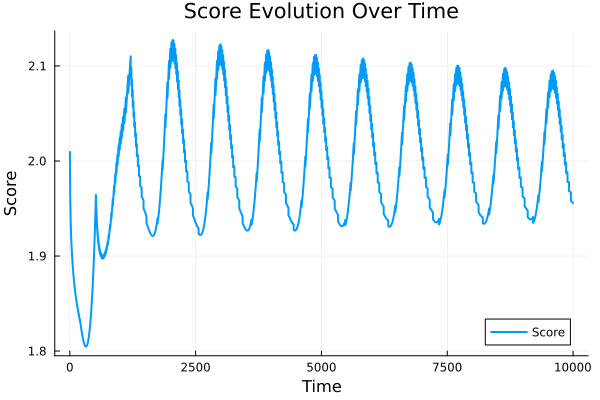

In [417]:
# 画出scores的变化
plot(1:t_max, scores, label="Score", xlabel="Time", ylabel="Score", title="Score Evolution Over Time", linewidth=2)

In [102]:
# 示例：计算最终策略的得分
final_score = calculate_final_score(P_t, R)
# println("Final score of the selected strategies: ", final_score)

2.254341870428711

# 无模型

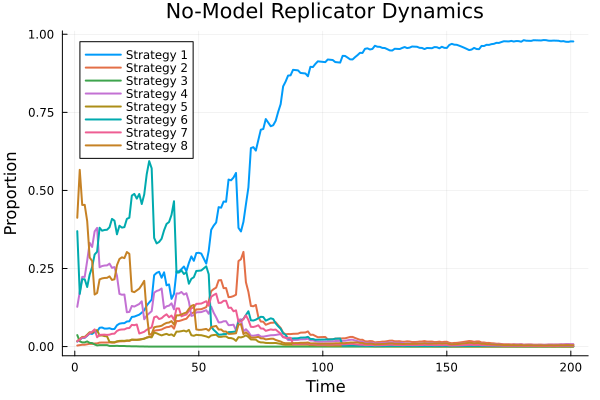

In [390]:
# 从策略分布中采样动作
function sample_action(strategy)
    # 将策略标准化为概率分布
    normalized_strategy = strategy / sum(strategy)
    # 计算累计分布函数 (CDF)
    cdf = cumsum(normalized_strategy)
    # 生成一个 [0, 1) 的随机数
    r = rand()
    # 找到 r 所对应的动作
    for (i, p) in enumerate(cdf)
        if r < p
            return i
        end
    end
end

# 模拟环境返回奖励
function simulate_environment(R, strategy, opponent_strategy, action, opponent_action) 
    # println(action)
    # println(opponent_action)
    # 获取动作对应的策略值
    new_strategy = zeros(Float64, length(strategy))   # 创建一个新的策略，长度与原策略相同
    
    # 将新的策略值赋给对应的动作
    new_strategy[action] = strategy[action]
    new_strategy[opponent_action] = opponent_strategy[opponent_action]

    
    # 归一化 new_strategy 使用广播
    sum_new_strategy = sum(new_strategy)
    
    # 使用广播来归一化 new_strategy
    new_strategy .= new_strategy / sum_new_strategy  # 广播方式归一化
    reward = 2 * calculate_final_score(new_strategy, R) / (calculate_final_score(strategy, R) + calculate_final_score(opponent_strategy, R))
    
    return reward
end



# 更新策略分布（基于经验）
function update_strategy(strategy, action, opponent_action, reward, alpha=0.01)
    m = length(strategy)
    strategy .= (1 - alpha) .* strategy  # 衰减现有分布
    # 将 reward 向 1 压缩
    reward_compressed = 1 - (1 - reward) * exp(-alpha)
    strategy[action] *= reward_compressed  # 增强选择的策略
    strategy[opponent_action] *= reward_compressed  # 增强选择的策略
    strategy .= strategy ./ sum(strategy)  # 归一化
end

# 模拟无模型动态
function simulate_no_model_dynamics(R, strategy, opponent_strategy, m, t_max, alpha=0.1, record_interval=10)

    strategy_history = []
    score_history = []

    for t in 1:t_max
        # 自己和对手各自采样一个动作
        action = sample_action(strategy)
        opponent_action = sample_action(opponent_strategy)

        # 通过环境交互得到奖励
        reward = simulate_environment(R, strategy, opponent_strategy, action, opponent_action)
        # println(reward)

        # 更新自己的策略分布
        update_strategy(strategy, action, opponent_action, reward, alpha)

        # 每隔 `record_interval` 步记录一次策略
        push!(strategy_history, copy(strategy))
        current_score = calculate_final_score(strategy, R)
        push!(score_history, current_score)
    end

    return hcat(strategy_history...), score_history
end

R = [  # 8个策略的奖励矩阵
    3.0  0.0  5.0  0.0  0.0  5.0  0.0  3.0;
    5.0  1.0  1.0  3.0  2.0  1.0  1.0  5.0;
    0.0  3.0  0.0  2.0  5.0  0.0  3.0  0.0;
    5.0  0.0  3.0  1.0  1.0  2.0  0.0  0.0;
    3.0  0.0  5.0  0.0  2.0  1.0  3.0  0.0;
    1.0  3.0  0.0  2.0  3.0  2.0  1.0  1.0;
    0.0  2.0  5.0  3.0  1.0  5.0  1.0  0.0;
    1.0  0.0  3.0  2.0  5.0  3.0  0.0  1.0
]

# 参数设置
m = 8  # 策略数量
t_max = 200 # 模拟时间步长
alpha = 0.1  # 学习率

# strategy = initialize_gaussian_distribution(8, 0.0, 1.0)   # 初始化策略分布
# opponent_strategy = initialize_gaussian_distribution(8, 0.0, 1.0)   # 对手策略分布
strategy = initialize_gaussian_distribution(8, 0.0, 1.0) # 初始化策略分布
opponent_strategy = initialize_gaussian_distribution(8, 0.0, 1.0)# 对手策略分布


# 模拟并绘图
strategy_history_matrix, scores = simulate_no_model_dynamics(R, strategy, opponent_strategy, m, t_max + 1, alpha)

# 绘制各策略随时间的变化
p = plot(1:t_max+ 1, strategy_history_matrix[1, :], label="Strategy 1", xlabel="Time", ylabel="Proportion", title="No-Model Replicator Dynamics", linewidth=2)
plot!(1:t_max + 1, strategy_history_matrix[2, :], label="Strategy 2", linewidth=2)
plot!(1:t_max + 1, strategy_history_matrix[3, :], label="Strategy 3", linewidth=2)
plot!(1:t_max + 1, strategy_history_matrix[4, :], label="Strategy 4", linewidth=2)
plot!(1:t_max + 1, strategy_history_matrix[5, :], label="Strategy 5", linewidth=2)
plot!(1:t_max + 1, strategy_history_matrix[6, :], label="Strategy 6", linewidth=2)
plot!(1:t_max + 1, strategy_history_matrix[7, :], label="Strategy 7", linewidth=2)
plot!(1:t_max + 1, strategy_history_matrix[8, :], label="Strategy 8", linewidth=2)


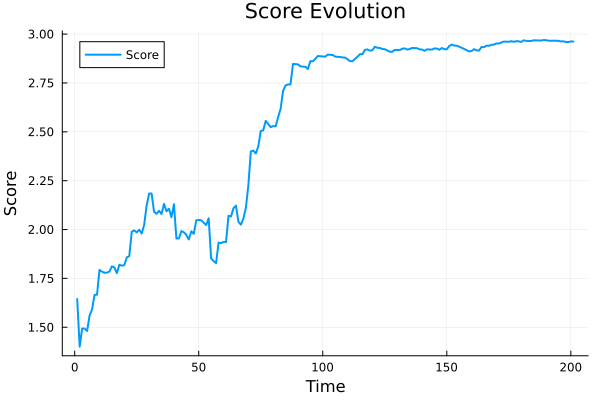

In [391]:
# 绘制得分随时间变化的图
plot(1:t_max + 1, scores, xlabel="Time", ylabel="Score", title="Score Evolution", linewidth=2, label="Score")